In [1]:
import time
import numpy as np
import pandas as pd
from collections import Counter

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms.functional
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, transforms
from torchvision.datasets import ImageFolder

from PIL import Image

from collections import defaultdict

import os
from tqdm.autonotebook import tqdm
from ema_pytorch import EMA
import wandb
import random
import copy
import matplotlib.pyplot as plt
import gc
import pickle
from IPython.display import display
import xlsxwriter
from concurrent.futures import ThreadPoolExecutor, as_completed

/tmp/ipykernel_2228958/3673441264.py:19: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from tqdm.autonotebook import tqdm


In [2]:
!nvidia-smi | grep '/vol/bitbucket/ms922/myenv/bin/python' | awk '{ print $5 }' | xargs -n1 kill -9


Usage:
 kill [options] <pid> [...]

Options:
 <pid> [...]            send signal to every <pid> listed
 -<signal>, -s, --signal <signal>
                        specify the <signal> to be sent
 -q, --queue <value>    integer value to be sent with the signal
 -l, --list=[<signal>]  list all signal names, or convert one to a name
 -L, --table            list all signal names in a nice table

 -h, --help     display this help, and exit
 -V, --version  output version information, and exit

For more details, see kill(1).


In [3]:
!nvidia-smi

Thu Jul  4 09:06:42 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.183.01             Driver Version: 535.183.01   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce RTX 2080 Ti     Off | 00000000:21:00.0 Off |                  N/A |
| 30%   32C    P8              20W / 250W |     86MiB / 11264MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

# Networks

In [4]:
from networks import * 
from gan.networks import * 

In [5]:
from glad_utils import build_dataset, prepare_latents, get_optimizer_img, get_eval_lrs, eval_loop_v2

# Config

In [7]:
from utils import config

# Dataset

In [ ]:
from utils import get_dataset

# Network Utils

In [10]:
from utils import get_default_convnet_setting, get_network, get_time

# Epoch

In [11]:
from utils import epoch, evaluate_synset, get_eval_pool

# DSA

In [12]:
from utils import ParamDiffAug, DiffAugment

# Arguments

In [13]:
import argparse

def add_shared_args():
    parser = argparse.ArgumentParser(description='Parameter Processing')
    parser.add_argument('--dataset', type=str, default='CIFAR10', help='dataset')
    parser.add_argument('--model', type=str, default='ConvNet', help='model')
    parser.add_argument('--ipc', type=int, default=1, help='image(s) per class')
    parser.add_argument('--eval_mode', type=str, default='M',
                        help='eval_mode')  # S: the same to training model, M: multi architectures
    parser.add_argument('--num_eval', type=int, default=5, help='the number of evaluating randomly initialized models')
    parser.add_argument('--eval_it', type=int, default=100, help='how often to evaluate')
    parser.add_argument('--save_it', type=int, default=None, help='how often to evaluate')
    parser.add_argument('--epoch_eval_train', type=int, default=1000,
                        help='epochs to train a model with synthetic data')
    parser.add_argument('--Iteration', type=int, default=1000, help='training iterations')

    parser.add_argument('--mom_img', type=float, default=0.5, help='momentum for updating synthetic images')

    parser.add_argument('--batch_real', type=int, default=256, help='batch size for real data')
    parser.add_argument('--batch_train', type=int, default=256, help='batch size for training networks')
    parser.add_argument('--batch_test', type=int, default=128, help='batch size for training networks')

    parser.add_argument('--pix_init', type=str, default='noise', choices=["noise", "real"],
                        help='noise/real: initialize synthetic images from random noise or randomly sampled real images.')
    parser.add_argument('--dsa', type=str, default='True', choices=['True', 'False'],
                        help='whether to use differentiable Siamese augmentation.')
    parser.add_argument('--dsa_strategy', type=str, default='color_crop_cutout_flip_scale_rotate',
                        help='differentiable Siamese augmentation strategy')
    parser.add_argument('--data_path', type=str, default='data', help='dataset path')

    parser.add_argument('--save_path', type=str, default='result', help='path to save results')

    parser.add_argument('--space', type=str, default='p', choices=['p', 'wp'])
    parser.add_argument('--res', type=int, default=128, choices=[128, 256, 512], help='resolution')
    parser.add_argument('--layer', type=int, default=12)
    parser.add_argument('--avg_w', action='store_true')

    parser.add_argument('--eval_all', action='store_true')

    parser.add_argument('--min_it', type=bool, default=False)
    parser.add_argument('--no_aug', type=bool, default=False)

    parser.add_argument('--force_save', action='store_true')

    parser.add_argument('--sg_batch', type=int, default=10)

    parser.add_argument('--rand_f', action='store_true')

    parser.add_argument('--logdir', type=str, default='./logged_files')

    parser.add_argument('--wait_eval', action='store_true')

    parser.add_argument('--idc_factor', type=int, default=1)

    parser.add_argument('--rand_gan_un', action='store_true')
    parser.add_argument('--rand_gan_con', action='store_true')

    parser.add_argument('--learn_g', action='store_true')

    parser.add_argument('--width', type=int, default=128)
    parser.add_argument('--depth', type=int, default=5)


    parser.add_argument('--special_gan', default=None)

    return parser

In [14]:
parser = add_shared_args()

parser.add_argument('--lr_teacher', type=float, default=0.01, help='learning rate for updating network parameters')
parser.add_argument('--batch_syn', type=int, default=None, help='batch size for syn data')
parser.add_argument('--buffer_path', type=str, default='./buffers', help='buffer path')
parser.add_argument('--load_all', action='store_true')
parser.add_argument('--max_start_epoch', type=int, default=5)
parser.add_argument('--max_files', type=int, default=None)
parser.add_argument('--max_experts', type=int, default=None)
parser.add_argument('--expert_epochs', type=int, default=3, help='how many expert epochs the target params are')
parser.add_argument('--syn_steps', type=int, default=20, help='how many steps to take on synthetic data')

parser.add_argument('--lr_img', type=float, default=10000 , help='learning rate for pixels or f_latents')
parser.add_argument('--lr_w', type=float, default=10, help='learning rate for updating synthetic latent w')
parser.add_argument('--lr_lr', type=float, default=1e-06, help='learning rate learning rate')
parser.add_argument('--lr_g', type=float, default=0.1, help='learning rate for gan weights')

args = parser.parse_args([])

In [15]:
args.num_eval = 5
args.Iteration = 2_000
# args.lr_img = 1
# args.dataset = "CIFAR10"
# args.dataset = "videonet"
args.dataset = "ultrasound"
args.ipc = 50
args.space = "p"
args.eval_it = 500
args.method = "dm"
args.depth = 4
args.res = 64
args.nz = 100
args.epoch_eval_train = 100

# args.per_video = True

args.use_gan = True
args.per_video = False
args.add_variance = False
args.init_beta_dist = False

args.device = 'cuda' if torch.cuda.is_available() else 'cpu'
args.dsa_param = ParamDiffAug()
args.dsa = False if args.dsa_strategy in ['none', 'None'] else True

In [16]:
torch.random.manual_seed(0)
np.random.seed(0)
random.seed(0)

run = wandb.init(
    project="GLaD",
    job_type="MTT",
    config=args
)

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: jack47744. Use `wandb login --relogin` to force relogin


In [17]:
eval_it_pool = np.arange(0, args.Iteration + 1, args.eval_it).tolist()
channel, im_size, num_classes, class_names, mean, std, dst_train, dst_test, testloader, loader_train_dict, class_map, class_map_inv = get_dataset(
    args.dataset, args.data_path, args.batch_real, args.res, args=args)

model_eval_pool = get_eval_pool(args.eval_mode, args.model, args.model)

accs_all_exps = dict() # record performances of all experiments
for key in model_eval_pool:
    accs_all_exps[key] = []

data_save = []
args.distributed = torch.cuda.device_count() > 1

In [19]:
if args.use_gan:
    dataset_dict_path = f'dataset_dict_{args.dataset}_gan.pkl'
else:
    dataset_dict_path = f'dataset_dict_{args.dataset}.pkl'

print(dataset_dict_path)

if os.path.exists(dataset_dict_path):
    with open(dataset_dict_path, 'rb') as file:
        images_all, labels_all, indices_class = pickle.load(file)
else:
    images_all, labels_all, indices_class = build_dataset(dst_train, class_map, num_classes)
    dataset_dict = images_all, labels_all, indices_class
    with open(dataset_dict_path, 'wb') as pickle_file:
        pickle.dump(dataset_dict, pickle_file)

dataset_dict_ultrasound_gan.pkl


In [20]:
G, zdim = None, None

def get_images(c, n):
    idx_shuffle = np.random.permutation(indices_class[c])[:n]
    return images_all[idx_shuffle].to(args.device)

def get_images_per_video(video_id, n):
    idx_shuffle = np.random.permutation(indices_video[video_id])[:n]
    return images_all[idx_shuffle].to(args.device)

In [22]:
if args.use_gan:
    mean_tensor = torch.Tensor([0.5])
    std_tensor = torch.Tensor([0.5])
else:
    mean_tensor = torch.Tensor(mean)
    std_tensor = torch.Tensor(std)
unnormalize = transforms.Normalize((-mean_tensor / std_tensor).tolist(), (1.0 / std_tensor).tolist())

def denorm(x, channels=None, w=None ,h=None, resize = False):

    x = unnormalize(x)
    if resize:
        if channels is None or w is None or h is None:
            print('Number of channels, width and height must be provided for resize.')
        x = x.view(x.size(0), channels, w, h)
    return x

def display_latent(latent, num_classes, n_img, is_denorm=False):
    # reshaped_tensor = latent.view(num_classes*args.ipc, channel, im_size[0], im_size[1])
    reshaped_tensor = latent.view(-1, channel, im_size[0], im_size[1])
    if is_denorm:
        reshaped_tensor = denorm(reshaped_tensor, channel, im_size[0], im_size[1])
    reshaped_tensor = reshaped_tensor.view(num_classes, n_img, channel, im_size[0], im_size[1]).detach().cpu()
    # Plotting
    fig, axs = plt.subplots(n_img, num_classes, figsize=(num_classes*1.5, n_img))
    for i in range(num_classes):
        for j in range(n_img):
            if args.dataset == "ultrasound":
                axs[j, i].imshow(reshaped_tensor[i, j].squeeze(0), cmap='gray')
            else:
                axs[j, i].imshow(reshaped_tensor[i, j].permute(1, 2, 0), )
            axs[j, i].axis('off')
            axs[j, i].set_title(f'Class {i + 1}, Image {j + 1}', fontsize=8)

    plt.tight_layout()
    plt.show()

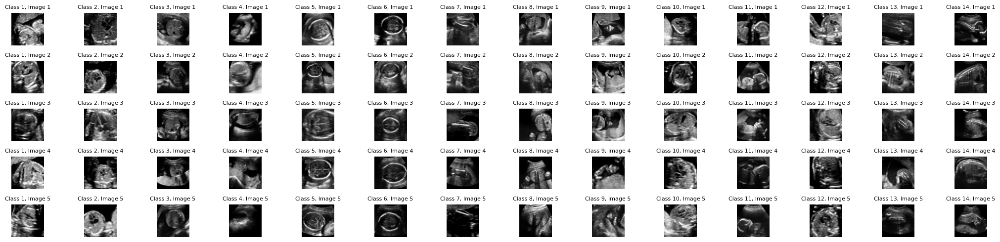

In [23]:
n_img = 5

real_img_tmp_list = [get_images(c, n_img) for c in range(num_classes)]
real_img_tmp_tensor = torch.cat(real_img_tmp_list)
display_latent(real_img_tmp_tensor, num_classes, n_img, True)

In [24]:
if args.per_video:
    num_video = 10
    n_img = 5
    video_id_sample_list = np.random.choice(list(indices_video.keys()), num_video)
    real_img_tmp_list = [get_images_per_video(video_id, n_img) for video_id in video_id_sample_list]
    real_img_tmp_tensor = torch.cat(real_img_tmp_list)
    # print(real_img_tmp_tensor.shape)
    display_latent(real_img_tmp_tensor, num_video, n_img, True)

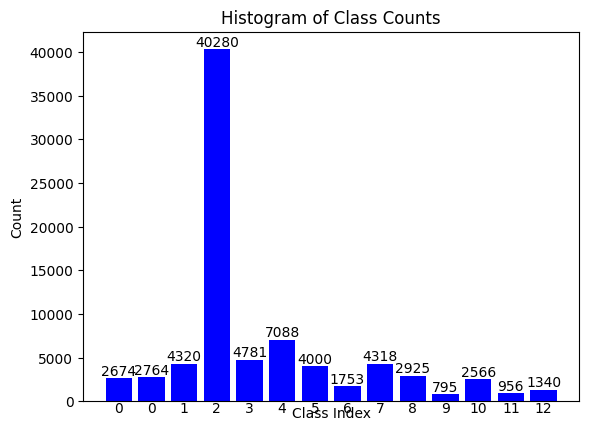

In [25]:
unique, counts = np.unique(labels_all.numpy(), return_counts=True)
dist = list(zip(unique, counts))
class_indices = [pair[0] for pair in dist]
counts = [pair[1] for pair in dist]

# Plot the histogram
bars = plt.bar(class_indices, counts, color='blue')

# Add labels and title
plt.xlabel('Class Index')
plt.ylabel('Count')
plt.title('Histogram of Class Counts')
plt.xticks([])

for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), ha='center', va='bottom')

for bar in bars:
    plt.text(bar.get_x() + bar.get_width()/2, -10, str(int(bar.get_x())), ha='center', va='top')
plt.show()


In [26]:
label_number_to_name_dict = {
    0: '10_3VV', 
    1: '09_4CH', 
    2: '04_ABDOMINAL', 
    3: '13_BACKGROUND', 
    4: '00_BRAIN-CB', 
    5: '01_BRAIN-TV', 
    6: '06_FEMUR',
    7: '05_KIDNEYS', 
    8: '03_LIPS', 
    9: '12_LVOT', 
    10: '02_PROFILE', 
    11: '11_RVOT', 
    12: '07_SPINE-CORONAL', 
    13: '08_SPINE-SAGITTAL'
}

In [27]:
def count_classes(dataloader):
    class_counts = Counter()
    
    for _, labels in tqdm(dataloader):
        class_counts.update(labels.cpu().numpy())
    
    return class_counts

def get_processed_metrics(metric_list_all):
    metric_list_full = []
    conf_mtx_list = []

    for metric_list in metric_list_all:
        metric_dict = metric_list[0]
        metric_list_full.append({i:metric_dict[i] for i in metric_dict if i!='confusion_matrix'})
        conf_mtx_list.append(metric_dict["confusion_matrix"])

    metric_df = pd.DataFrame(metric_list_full)
    precision_arr = np.array(metric_df["precision"].tolist())
    recall_arr = np.array(metric_df["recall"].tolist())
    f1_arr = np.array(metric_df["f1"].tolist())
    accuracy_arr = metric_df["accuracy"].to_numpy()
    conf_mtx_arr = np.array(conf_mtx_list)

    return precision_arr, recall_arr, f1_arr, accuracy_arr, conf_mtx_arr

def process_mean_std_metrics(precision_arr, recall_arr, f1_arr, accuracy_arr, conf_mtx_arr, class_count):
    mean_df = pd.DataFrame({
        "class": [label_number_to_name_dict[i] for i in range(num_classes)],
        "precision_avg": precision_arr.mean(axis=0),
        "recall_avg": recall_arr.mean(axis=0),
        "f1_avg": f1_arr.mean(axis=0),
        "img_cnt": class_count,
    }).sort_values(by=['class'])

    std_df = pd.DataFrame({
        "class": [label_number_to_name_dict[i] for i in range(num_classes)],
        "precision_std": precision_arr.std(axis=0),
        "recall_std": recall_arr.std(axis=0),
        "f1_std": f1_arr.std(axis=0),
        "img_cnt": class_count,
    }).sort_values(by=['class'])

    mean_conf_mtx = pd.DataFrame(conf_mtx_arr.mean(axis=0))
    std_conf_mtx = pd.DataFrame(conf_mtx_arr.std(axis=0))

    mean_conf_mtx.rename(columns=label_number_to_name_dict, index=label_number_to_name_dict, inplace=True)
    std_conf_mtx.rename(columns=label_number_to_name_dict, index=label_number_to_name_dict, inplace=True)

    mean_conf_mtx.sort_index(axis=0, inplace=True)
    mean_conf_mtx.sort_index(axis=1, inplace=True)
    std_conf_mtx.sort_index(axis=0, inplace=True)
    std_conf_mtx.sort_index(axis=1, inplace=True)

    mean_acc = accuracy_arr.mean(axis=0)
    std_acc = accuracy_arr.std(axis=0)

    print(f"Accuracy avg:{mean_acc:05f}, std:{std_acc:05f}")

    return mean_df, std_df, mean_conf_mtx, std_conf_mtx, mean_acc, std_acc

def get_excel_data_range(start_row_arr, start_col_arr, height, width):
    start_cell = xlsxwriter.utility.xl_rowcol_to_cell(start_row_arr, start_col_arr)
    end_cell = xlsxwriter.utility.xl_rowcol_to_cell(start_row_arr + height - 1, start_col_arr + width - 1)
    data_range = f'{start_cell}:{end_cell}'
    return data_range

def cond_color_cell(worksheet, start_row_arr, start_col_arr, height, width, max_green=True):
    data_range = get_excel_data_range(start_row_arr, start_col_arr, height, width)
    if max_green:
        worksheet.conditional_format(data_range, {'type': '3_color_scale',
                                        'min_color': "#F8696B",  # Red
                                        'mid_color': "#FFEB84",  # Yellow
                                        'max_color': "#63BE7B"})  # Green
    else:
        worksheet.conditional_format(data_range, {'type': '3_color_scale',
                                          'min_color': "#63BE7B",  # Green
                                          'mid_color': "#FFEB84",  # Yellow
                                          'max_color': "#F8696B"})  # Red
        
def cond_bar_cell(worksheet, start_row_arr, start_col_arr, height, width, color="#63C384"):
    data_range = get_excel_data_range(start_row_arr, start_col_arr, height, width)
    worksheet.conditional_format(data_range, {'type': 'data_bar',
                                          'bar_color': color})

def save_res_dict_excel(res_dict, class_count, dir, file_prefix=""):
    for model_eval, metric_test_all in res_dict.items():

        precision_arr, recall_arr, f1_arr, accuracy_arr, conf_mtx_arr = get_processed_metrics(metric_test_all)

        mean_df, std_df, mean_conf_mtx, std_conf_mtx, mean_acc, std_acc = process_mean_std_metrics(
            precision_arr, recall_arr, f1_arr, accuracy_arr, conf_mtx_arr, class_count
        )

        if not os.path.exists(dir):
            os.makedirs(dir)

        file_name = os.path.join(dir, f"{file_prefix}{args.dataset}_{args.ipc:03d}_{model_eval}.xlsx")
        with pd.ExcelWriter(file_name, engine='xlsxwriter') as writer:

            workbook  = writer.book
            sheet_name = model_eval
            worksheet = workbook.add_worksheet(sheet_name)
            
            row = 2
            col = 2
            worksheet.write(f'B{row}', 'Mean')
            mean_df.to_excel(writer, sheet_name=sheet_name, startrow=row, startcol=col, index=False)
            cond_color_cell(worksheet, row+1, col+1, mean_df.shape[0], 1, max_green=True)
            cond_color_cell(worksheet, row+1, col+2, mean_df.shape[0], 1, max_green=True)
            cond_color_cell(worksheet, row+1, col+3, mean_df.shape[0], 1, max_green=True)
            cond_bar_cell(worksheet, row+1, col+4, mean_df.shape[0], 1, color="#63C384")
            row += len(mean_df) + 4

            worksheet.write(f'B{row}', 'STD')
            std_df.to_excel(writer, sheet_name=sheet_name, startrow=row, startcol=col, index=False)
            cond_color_cell(worksheet, row+1, col+1, std_df.shape[0], 1, max_green=False)
            cond_color_cell(worksheet, row+1, col+2, std_df.shape[0], 1, max_green=False)
            cond_color_cell(worksheet, row+1, col+3, std_df.shape[0], 1, max_green=False)
            cond_bar_cell(worksheet, row+1, col+4, mean_df.shape[0], 1, color="#63C384")
            row += len(std_df) + 4

            worksheet.write(f'B{row}', 'Confusion Matrix Mean')
            mean_conf_mtx.to_excel(writer, sheet_name=sheet_name, startrow=row, startcol=col, index=True)
            cond_color_cell(worksheet, row+1, col+1, mean_conf_mtx.shape[0], mean_conf_mtx.shape[1], max_green=True)
            row += len(mean_conf_mtx) + 4

            worksheet.write(f'B{row}', 'Confusion Matrix STD')
            std_conf_mtx.to_excel(writer, sheet_name=sheet_name, startrow=row, startcol=col, index=True)
            cond_color_cell(worksheet, row+1, col+1, std_conf_mtx.shape[0], std_conf_mtx.shape[1], max_green=False)
            row += len(std_conf_mtx) + 4

            worksheet.write(f'B{row}', 'Accuracy Mean')
            worksheet.write(f'C{row}', mean_acc)
            row += 1

            worksheet.write(f'B{row}', 'Accuracy STD')
            worksheet.write(f'C{row}', std_acc)
        

In [28]:
test_class_count = count_classes(testloader)
test_class_count = list(dict(sorted(test_class_count.items())).values())

100%|██████████| 299/299 [00:32<00:00,  9.18it/s]


# Training All

In [62]:
torch.random.manual_seed(0)
np.random.seed(0)
random.seed(0)

args.epoch_eval_train = 50

res_dict = {}

# model_eval_list = ["ConvNet", "ResNet18", "AlexNet", "VGG11", "ViT"]
# model_eval_list = ["ConvNet"]
eval_pool_dict = get_eval_lrs(args)
for model_eval in model_eval_list:
    # if model_eval == "ConvNet":
    #     continue
    print(f"model: {model_eval}")
    args.lr_net = eval_pool_dict[model_eval]
    metric_train_all = []
    metric_test_all = []
    for it_eval in range(args.num_eval):
        torch.cuda.empty_cache()
        gc.collect()
        net = get_network(model_eval, channel, num_classes, im_size, depth=args.depth, width=args.width).to(args.device) # get a random model
        net.train()
        _, metric_train_list, metric_test_list = evaluate_synset(it_eval, net, images_all, labels_all, testloader, args, decay="cosine", aug=True)
        metric_train_all.append(metric_train_list)
        metric_test_all.append(metric_test_list)
    res_dict[model_eval] = metric_test_all

model: ConvNet


  2%|▏         | 1/50 [00:20<16:24, 20.10s/it]

In [ ]:
dir = "../experiment_res/full_dataset"
save_res_dict_excel(res_dict, test_class_count, dir, file_prefix="full_dataset_")

NameError: name 'res_dict' is not defined

# Training Random Image subset

In [93]:
torch.random.manual_seed(0)
np.random.seed(0)
random.seed(0)

args.epoch_eval_train = 500

model_eval_list = ["ConvNet", "ResNet18", "VGG11", "ViT"]
# model_eval_list = ["ViT"]

res_random_dict = {}

eval_pool_dict = get_eval_lrs(args)
for model_eval in model_eval_list:
    args.lr_net = eval_pool_dict[model_eval]
    print(f"model: {model_eval}")
    metric_train_all = []
    metric_test_all = []
    for it_eval in range(args.num_eval):
        torch.cuda.empty_cache()
        gc.collect()
        if args.per_video:
            random_image_list = torch.cat([get_images_per_video(c, args.ipc) for c in video_id_list])
            random_label_list = torch.tensor([int(c.split("__")[1]) for c in video_id_list for _ in range(args.ipc)])
        else:
            random_image_list = torch.cat([get_images(c, args.ipc) for c in range(num_classes)])
            random_label_list = torch.tensor([label for label in range(num_classes) for _ in range(args.ipc)])
        net = get_network(model_eval, channel, num_classes, im_size, depth=args.depth, width=args.width).to(args.device) 
        net.train()
        _, metric_train_list, metric_test_list = evaluate_synset(
            it_eval, net, random_image_list, random_label_list, testloader, args, decay="cosine", aug=True
        )
        metric_train_all.append(metric_train_list)
        metric_test_all.append(metric_test_list)
    
    res_random_dict[model_eval] = metric_test_all

model: ViT


100%|██████████| 500/500 [01:15<00:00,  6.59it/s]


In [94]:
dir = "../experiment_res/random"
save_res_dict_excel(res_random_dict, test_class_count, dir, file_prefix="random_")

Accuracy avg:0.110321, std:0.019494


# Load Pretrained GAN

In [95]:
from gan.networks import Generator

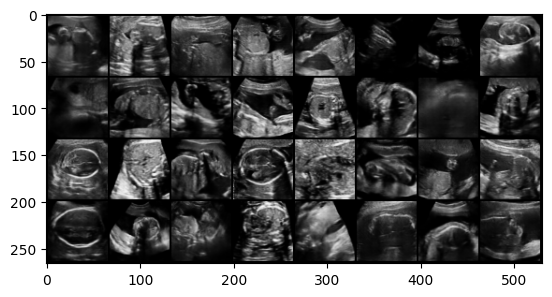

In [98]:
from torchvision.utils import make_grid

def show(img):
    npimg = img.cpu().numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)))

if args.use_gan:

    nz = 100  # Size of z latent vector (i.e., generator input)
    ngf = 64  # Size of feature maps in generator
    ndf = 64  # Size of feature maps in discriminator
    nc = 1    # Number of channels in the training images

    generator = Generator(nz, ngf, nc).to(args.device)
    generator.load_state_dict(torch.load("../gan/models/net_G_relu_64_video_net_new_epoch_49.pth"))

    generator = generator.eval()
    for param in generator.parameters():
        param.requires_grad = False
    fixed_noise = torch.randn(32, args.nz, 1, 1, device=args.device)
    with torch.no_grad():
        fake = generator(fixed_noise)
    show(make_grid(denorm(fake), nrow=8, padding=2, normalize=False, value_range=None, scale_each=False, pad_value=0))

# Training MTT

In [29]:
from torchvision.utils import save_image

torch.random.manual_seed(0)
np.random.seed(0)
random.seed(0)

model_eval_pool = ["ConvNet"]

if args.use_gan:
    label_syn = torch.tensor([i*np.ones(args.ipc, dtype=np.int64) for i in range(num_classes)], dtype=torch.long, requires_grad=False, device=args.device).view(-1) # [0,0,0, 1,1,1, ..., 9,9,9]
    if args.init_beta_dist:
        alpha, beta = 0.5, 0.5
        latents = torch.distributions.Beta(alpha, beta).sample((num_classes, args.ipc, args.nz))
        latents = latents.reshape(num_classes * args.ipc, args.nz, 1, 1)
        latents = latents.float().requires_grad_(False).to(args.device)
    else:
        latents = torch.randn(size=(num_classes * args.ipc, args.nz, 1, 1), dtype=torch.float, requires_grad=False, device=args.device)
    f_latents = None
    latents = latents.detach().to(args.device).requires_grad_(True)
else:
    latents, f_latents, label_syn = prepare_latents(channel=channel, num_classes=num_classes, im_size=im_size,
                                                    zdim=zdim, G=G, class_map_inv=class_map_inv, get_images=get_images,
                                                    args=args)


syn_lr = torch.tensor(args.lr_teacher, requires_grad=True).to(args.device)
syn_lr = syn_lr.detach().to(args.device).requires_grad_(True)
optimizer_lr = torch.optim.SGD([syn_lr], lr=args.lr_lr, momentum=0.5)

optimizer_img = get_optimizer_img(latents=latents, f_latents=f_latents, G=G, args=args)

criterion = nn.CrossEntropyLoss().to(args.device)
print('%s training begins'%get_time())

expert_dir = os.path.join(args.buffer_path, args.dataset)
expert_dir = os.path.join(expert_dir, args.model)
expert_dir = os.path.join(expert_dir, "depth-{}".format(args.depth), "width-{}".format(args.width))
print("Expert Dir: {}".format(expert_dir))

if args.load_all:
    buffer = []
    n = 0
    while os.path.exists(os.path.join(expert_dir, "replay_buffer_{}.pt".format(n))):
        buffer = buffer + torch.load(os.path.join(expert_dir, "replay_buffer_{}.pt".format(n)))
        n += 1

else:
    expert_files = []
    n = 0
    while os.path.exists(os.path.join(expert_dir, "replay_buffer_{}.pt".format(n))):
        expert_files.append(os.path.join(expert_dir, "replay_buffer_{}.pt".format(n)))
        n += 1
    file_idx = 0
    expert_idx = 0
    random.shuffle(expert_files)
    if args.max_files is not None:
        expert_files = expert_files[:args.max_files]
    print("loading file {}".format(expert_files[file_idx]))
    buffer = torch.load(expert_files[file_idx])
    if args.max_experts is not None:
        buffer = buffer[:args.max_experts]
    random.shuffle(buffer)

/tmp/ipykernel_2228958/2088145374.py:10: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:274.)
  label_syn = torch.tensor([i*np.ones(args.ipc, dtype=np.int64) for i in range(num_classes)], dtype=torch.long, requires_grad=False, device=args.device).view(-1) # [0,0,0, 1,1,1, ..., 9,9,9]


[2024-07-04 09:13:37] training begins
Expert Dir: ./buffers/ultrasound/ConvNet/depth-4/width-128


IndexError: list index out of range

In [ ]:
for it in range(0, args.Iteration+1):
        save_this_it = False

        wandb.log({"Progress": it}, step=it)
        ''' Evaluate synthetic data '''
        if it in eval_it_pool:
            res_dict = eval_loop_v2(latents=latents, f_latents=f_latents, label_syn=label_syn, G=G, best_acc=best_acc, best_std=best_std, testloader=testloader,
                                     model_eval_pool=model_eval_pool, channel=channel, num_classes=num_classes, im_size=im_size, it=it, args=args)


        if (it in eval_it_pool and (save_this_it or it % 1000 == 0)) or (args.save_it is not None and it % args.save_it == 0):

            image_logging(latents=latents, f_latents=f_latents, label_syn=label_syn, G=G, it=it, save_this_it=save_this_it, args=args)

        wandb.log({"Synthetic_LR": syn_lr.detach().cpu()}, step=it)

        student_net = get_network(args.model, channel, num_classes, im_size, width=args.width, depth=args.depth, dist=False).to(args.device)  # get a random model

        num_params = sum([np.prod(p.size()) for p in (student_net.parameters())])

        if args.load_all:
            expert_trajectory = buffer[np.random.randint(0, len(buffer))]
        else:
            expert_trajectory = buffer[expert_idx]
            expert_idx += 1
            if expert_idx == len(buffer):
                expert_idx = 0
                file_idx += 1
                if file_idx == len(expert_files):
                    file_idx = 0
                    random.shuffle(expert_files)
                print("loading file {}".format(expert_files[file_idx]))
                if args.max_files != 1 and len(expert_files) > 1:
                    del buffer
                    buffer = torch.load(expert_files[file_idx])
                if args.max_experts is not None:
                    buffer = buffer[:args.max_experts]
                random.shuffle(buffer)

        start_epoch = np.random.randint(0, args.max_start_epoch)
        starting_params = expert_trajectory[start_epoch]

        target_params = expert_trajectory[start_epoch+args.expert_epochs]
        target_params = torch.cat([p.data.to(args.device).reshape(-1) for p in target_params], 0)

        student_params = [torch.cat([p.data.to(args.device).reshape(-1) for p in starting_params], 0).requires_grad_(True)]

        starting_params = torch.cat([p.data.to(args.device).reshape(-1) for p in starting_params], 0)

        student_net = ReparamModule(student_net)

        gradient_sum = torch.zeros(starting_params.shape).requires_grad_(False).to(args.device)

        param_dist = torch.tensor(0.0).to(args.device)

        param_dist += torch.nn.functional.mse_loss(starting_params, target_params, reduction="sum")

        if args.distributed:
            student_net = torch.nn.DataParallel(student_net)

        student_net.train()

        syn_images = latents[:]
        if args.space == "wp":
            with torch.no_grad():
                syn_images = torch.cat([latent_to_im(G, (syn_image_split.detach(), f_latents_split.detach()),
                                                    args=args).detach() for
                                       syn_image_split, f_latents_split, label_syn_split in
                                       zip(torch.split(syn_images, args.sg_batch),
                                           torch.split(f_latents, args.sg_batch),
                                           torch.split(label_syn, args.sg_batch))])
            syn_images.requires_grad_(True)

        image_syn = syn_images.detach()

        y_hat = label_syn
        x_list = []
        y_list = []
        indices_chunks = []
        indices_chunks_copy = []
        original_x_list = []
        gc.collect()

        syn_label_grad = torch.zeros(label_syn.shape).to(args.device).requires_grad_(False)
        syn_images_grad = torch.zeros(syn_images.shape).requires_grad_(False).to(args.device)

        for il in range(args.syn_steps):
            if not indices_chunks:
                indices = torch.randperm(len(syn_images))
                indices_chunks = list(torch.split(indices, args.batch_syn))

            these_indices = indices_chunks.pop()
            indices_chunks_copy.append(these_indices.clone())

            x = syn_images[these_indices]
            this_y = y_hat[these_indices]

            original_x_list.append(x)

            x = DiffAugment(x, args.dsa_strategy, param=args.dsa_param)

            x_list.append(x.clone())
            y_list.append(this_y.clone())

            forward_params = student_params[-1]

            forward_params = copy.deepcopy(forward_params.detach()).requires_grad_(True)

            if args.distributed:
                forward_params_expanded = forward_params.unsqueeze(0).expand(torch.cuda.device_count(), -1)
            else:
                forward_params_expanded = forward_params

            x = student_net(x, flat_param=forward_params_expanded)

            ce_loss = criterion(x, this_y)

            grad = torch.autograd.grad(ce_loss, forward_params, create_graph=True, retain_graph=True)[0]
            student_params.append(forward_params - syn_lr.item() * grad.detach().clone())
            gradient_sum = gradient_sum + grad.detach().clone()


        for il in range(args.syn_steps):
            w = student_params[il]

            if args.distributed:
                w_expanded = w.unsqueeze(0).expand(torch.cuda.device_count(), -1)
            else:
                w_expanded = w

            output = student_net(x_list[il], flat_param=w_expanded)

            if args.batch_syn:
                ce_loss = criterion(output, y_list[il])
            else:
                ce_loss = criterion(output, y_hat)

            grad = torch.autograd.grad(ce_loss, w, create_graph=True, retain_graph=True)[0]

            # Square term gradients.
            square_term = syn_lr.item() ** 2 * (grad @ grad)
            single_term = 2 * syn_lr.item() * grad @ (
                        syn_lr.item() * (gradient_sum - grad.detach().clone()) - starting_params + target_params)

            per_batch_loss = (square_term + single_term) / param_dist
            gradients = torch.autograd.grad(per_batch_loss, original_x_list[il], retain_graph=False)[0]

            with torch.no_grad():
                syn_images_grad[indices_chunks_copy[il]] += gradients

        # ---------end of computing input image gradients and learning rates--------------

        del w, output, ce_loss, grad, square_term, single_term, per_batch_loss, gradients, student_net, w_expanded, forward_params, forward_params_expanded

        optimizer_img.zero_grad()
        optimizer_lr.zero_grad()

        syn_lr.requires_grad_(True)
        grand_loss = starting_params - syn_lr * gradient_sum - target_params
        grand_loss = grand_loss.dot(grand_loss)
        grand_loss = grand_loss / param_dist

        lr_grad = torch.autograd.grad(grand_loss, syn_lr)[0]
        syn_lr.grad = lr_grad

        optimizer_lr.step()
        optimizer_lr.zero_grad()

        image_syn.requires_grad_(True)

        image_syn.grad = syn_images_grad.detach().clone()

        del syn_images_grad
        del lr_grad
        wandb.log({"Grand_Loss": grand_loss.detach().cpu(),
                   "Start_Epoch": start_epoch})

        for _ in student_params:
            del _
        for _ in x_list:
            del _
        for _ in y_list:
            del _


        torch.cuda.empty_cache()

        gc.collect()

        if args.space == "wp":
            # this method works in-line and back-props gradients to latents and f_latents
            gan_backward(latents=latents, f_latents=f_latents, image_syn=image_syn, G=G, args=args)

        else:
            latents.grad = image_syn.grad.detach().clone()

        optimizer_img.step()
        optimizer_img.zero_grad()


        if it%10 == 0:
            print('%s iter = %04d, loss = %.4f' % (get_time(), it, grand_loss.item()))

        if it == args.Iteration: # only record the final results
            data_save.append([copy.deepcopy(image_syn.detach().cpu()), copy.deepcopy(label_syn.detach().cpu())])
            torch.save({'data': data_save, 'accs_all_exps': accs_all_exps, }, os.path.join(args.save_path, 'res_%s_%s_%dipc.pt'%(args.dataset, args.model, args.ipc)))

    wandb.finish()

In [100]:
# model_eval_pool = ["ConvNet", "ResNet18", "AlexNet", "VGG11", "ViT"]
# best_acc = {"{}".format(m): 0 for m in model_eval_pool}
# eval_loop(latents=latents, f_latents=f_latents, label_syn=label_syn, G=G, best_acc=best_acc,
#                 best_std=best_std, testloader=testloader,
#                 model_eval_pool=model_eval_pool, channel=channel, num_classes=num_classes,
#                 im_size=im_size, it=it, args=args)

In [101]:
latent_dir = f"./dm_latents/{args.dataset}" if args.use_gan else f"./dm_latents/{args.dataset}_no_gan"
latent_path = os.path.join(latent_dir, f"{args.ipc}_ori_2000.pt")
latents_tmp = torch.load(latent_path, map_location=args.device, weights_only=True)
latents_tmp = latents_tmp.view(num_classes, args.ipc, channel, im_size[0], im_size[1])

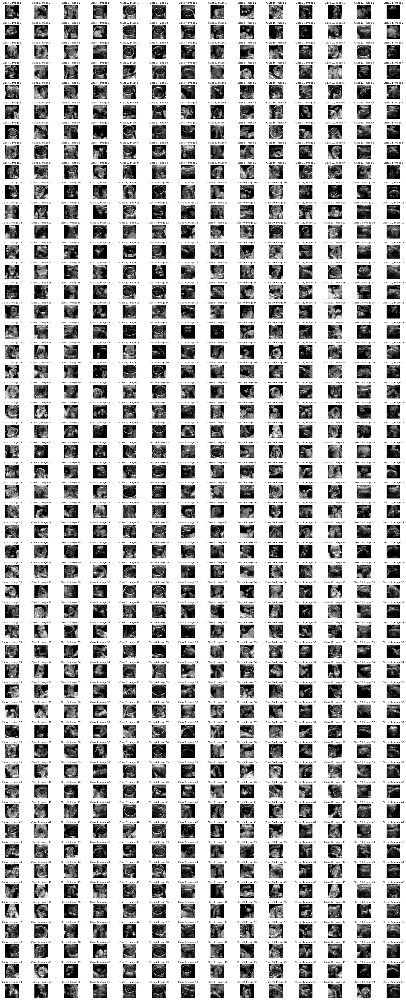

In [102]:
display_latent(latents_tmp, num_classes, args.ipc, True)

In [103]:
args.epoch_eval_train = 500

model_eval_pool = ["ConvNet"]
latents = latents_tmp.reshape(-1, channel, im_size[0], im_size[1])
label_syn = torch.tensor([i*np.ones(args.ipc, dtype=np.int64) for i in range(num_classes)], dtype=torch.long, requires_grad=False, device=args.device).view(-1)
res_dict = eval_loop_v2(latents=latents, f_latents=None, label_syn=label_syn, G=None, best_acc=None,
                best_std=None, testloader=testloader,
                model_eval_pool=model_eval_pool, channel=channel, num_classes=num_classes,
                im_size=im_size, it=0, args=args)

-------------------------
Evaluation
model_train = ConvNet, model_eval = ConvNet, iteration = 0


100%|██████████| 500/500 [01:28<00:00,  5.65it/s]


In [104]:
dir = "../experiment_res/latent_gen" if args.use_gan else "../experiment_res/latent_gen_no_gan"
file_prefix = "latent_gen_"  if args.use_gan else "latent_gen_no_gan_"
save_res_dict_excel(res_dict, test_class_count, dir, file_prefix=file_prefix)

Accuracy avg:0.328473, std:0.005813


In [62]:
from torchvision.models import vgg16

class VGGFeatureExtractor(nn.Module):
    def __init__(self, layers):
        super(VGGFeatureExtractor, self).__init__()
        self.vgg = vgg16(weights='IMAGENET1K_V1').features
        self.layers = layers
        self.selected_layers = [self.vgg[i] for i in self.layers]
        
    def forward(self, x, to_cpu=False):
        features = []
        for i, layer in enumerate(self.vgg):
            x = layer(x)
            if i in self.layers:
                features.append(x.cpu() if to_cpu else x)
        return features
    
class ConvertTo3Channel:
    def __call__(self, img):
        """
        Convert a 1-channel tensor image to a 3-channel tensor image.
        
        Args:
        img (torch.Tensor): The input image tensor of shape (C, H, W).
        
        Returns:
        torch.Tensor: The output image tensor of shape (3, H, W).
        """
        if img.shape[0] == 1:
            img = img.repeat(3, 1, 1)
        return img

def preprocess_image(image, target_size=(224, 224)):
    transform = transforms.Compose([
        transforms.Resize(target_size),
        transforms.Grayscale(num_output_channels=1),  # Convert to 3-channel grayscale
        ConvertTo3Channel(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    # image = Image.open(image_path).convert('L')  # Ensure image is in grayscale
    image = transform(image).unsqueeze(0)  # Add batch dimension
    return image

def calculate_mse(images1, images2):
    """Calculate the Mean Squared Error between two lists of preprocessed images."""
    mse_values = []
    criterion = torch.nn.MSELoss()
    for img1, img2 in zip(images1, images2):
        mse = criterion(img1, img2)
        mse_values.append(mse.item())
    return mse_values

def cal_total_mse_loss(embed1, embed2):
    loss = 0
    criterion = nn.MSELoss()
    for f1, f2 in zip(embed1, embed2):
        loss += criterion(f1.to(args.device), f2.to(args.device))
    
    return loss.item()

def cal_perceptual_loss(latents_tmp, layers):
    feature_extractor = VGGFeatureExtractor(layers).to(args.device)
    feature_extractor.eval()

    mse_latent_dict = defaultdict(list)

    with torch.no_grad():
        for c, img_class_idx in enumerate(indices_class):
            torch.cuda.empty_cache()
            gc.collect()

            img_class_embed_list = {}
            for img_idx in tqdm(img_class_idx, desc=f"Embedding Images of Class {c:02d}"):
                    
                img = images_all[img_idx].to(args.device)
                img_class_embed_list[img_idx] = feature_extractor(preprocess_image(img), True)
                del img
                torch.cuda.empty_cache()
                gc.collect()

            for latent_idx, latent in enumerate(tqdm(latents_tmp[c], desc="Processing Latents")):
                latent_embed = feature_extractor(preprocess_image(latent))
                
                for img_idx in img_class_idx:
                    img_embed = img_class_embed_list[img_idx]
                    mse_loss = cal_total_mse_loss(latent_embed, img_embed)
                    mse_latent_dict[(c, latent_idx)].append((mse_loss, img_idx))

                    del img_embed
                    torch.cuda.empty_cache()
                    gc.collect()

    
    return mse_latent_dict

In [63]:
# layers = [3, 8, 15, 22, 29]
# perceptual_mse_latent_dict = cal_perceptual_loss(latents_tmp, layers)

In [64]:
def get_most_similar_img(latents_tmp, get_mean_embed_only=False):
    net_list = [
        get_network(args.model, channel, num_classes, im_size, depth=args.depth, width=args.width).to(args.device).eval() for _ in range(10)
    ]

    embed_list = [net.module.embed if torch.cuda.device_count() > 1 else net.embed for net in net_list]
    del net_list

    mse_latent_dict = defaultdict(list)

    with torch.no_grad():

        latent_embed_mean_list = []

        for c, img_class_idx in enumerate(indices_class):
            torch.cuda.empty_cache()
            gc.collect()

            latent_embed_class_list = []

            img_latent_mean_list = {}
            for img_idx in tqdm(img_class_idx):
                    
                img = images_all[img_idx].to(args.device)
                img = torch.unsqueeze(img, 0)

                img_embed_list = [embed(img) for embed in embed_list]
                img_embed_list = torch.cat(img_embed_list)
                img_embed = torch.mean(img_embed_list, 0)
                img_latent_mean_list[img_idx] = img_embed

            for latent_idx, latent in enumerate(tqdm(latents_tmp[c], desc="Processing Latents")):
                
                latent = torch.unsqueeze(latent, 0)
                latent_embed_list = [embed(latent) for embed in embed_list]
                latent_embed_list = torch.cat(latent_embed_list)
                latent_embed = torch.mean(latent_embed_list, 0)
                latent_embed_class_list.append(latent_embed)

                if get_mean_embed_only:
                    continue

                for img_idx in img_class_idx:
                    img_embed = img_latent_mean_list[img_idx]
                    mse_loss = F.mse_loss(img_embed, latent_embed).item()
                    mse_latent_dict[(c, latent_idx)].append((mse_loss, img_idx))

            latent_embed_class_list = torch.stack(latent_embed_class_list, 0)
            latent_embed_mean_list.append(latent_embed_class_list)
        latent_embed_mean_list = torch.stack(latent_embed_mean_list, 0)
    
    return mse_latent_dict, latent_embed_mean_list


In [65]:
mse_latent_dict, latent_embed_mean_list = get_most_similar_img(latents_tmp)

Processing Latents: 100%|██████████| 50/50 [00:02<00:00, 22.51it/s]


In [66]:
mse_latent_dict_dir = "./dm_mse_latent_dict" if args.use_gan else "./dm_mse_latent_dict_no_gan"
if not os.path.exists(mse_latent_dict_dir):
    os.makedirs(mse_latent_dict_dir)

In [67]:
mse_latent_dict_path = os.path.join(mse_latent_dict_dir, f"{args.dataset}_{args.ipc:03d}.pkl")
with open(mse_latent_dict_path, 'wb') as file:
    pickle.dump(mse_latent_dict, file)

In [69]:
# Open the file in read-binary mode and load the dictionary

mse_latent_dict_path = os.path.join(mse_latent_dict_dir, f"{args.dataset}_{args.ipc:03d}.pkl")
with open(mse_latent_dict_path, 'rb') as file:
    mse_latent_dict = pickle.load(file)

In [73]:
def plot_images_with_similarity(all_img_top_k_list, similarity_loss_list, ipc):
    # Determine the number of classes

    
    # Create a figure with subplots in a grid: num_classes rows and ipc+1 columns
    fig, axs = plt.subplots(nrows=len(all_img_top_k_list), ncols=all_img_top_k_list[0].shape[0], figsize=(ipc * 2, num_classes * 2))
    
    for i, (images, similarity_losses) in enumerate(zip(all_img_top_k_list, similarity_loss_list)):
        # print(images.shape)
        for j in range(images.shape[0]):
            ax = axs[i, j]
            if args.use_gan:
                images[j] = denorm(torch.unsqueeze(images[j], 0), channels=None, w=None ,h=None, resize = False)
            else:
                images[j] = denorm(torch.unsqueeze(images[j], 0), channels=None, w=None ,h=None, resize = False)

            if images[j].shape[0] == 3:
                img = images[j].permute(1, 2, 0)  # Convert from (C, H, W) to (H, W, C)
                ax.imshow(img.numpy())
            else:

                ax.imshow(images[j].squeeze(0), cmap='gray')

            
            ax.axis('off')  # Turn off axis numbers and ticks
            
            # Annotate the top image with its similarity loss
            if j > 0:  # Skip the first image (latent image)
                ax.set_title(f"Loss: {similarity_losses[j-1]:.2f}", fontsize=8)

    plt.tight_layout()
    plt.show()

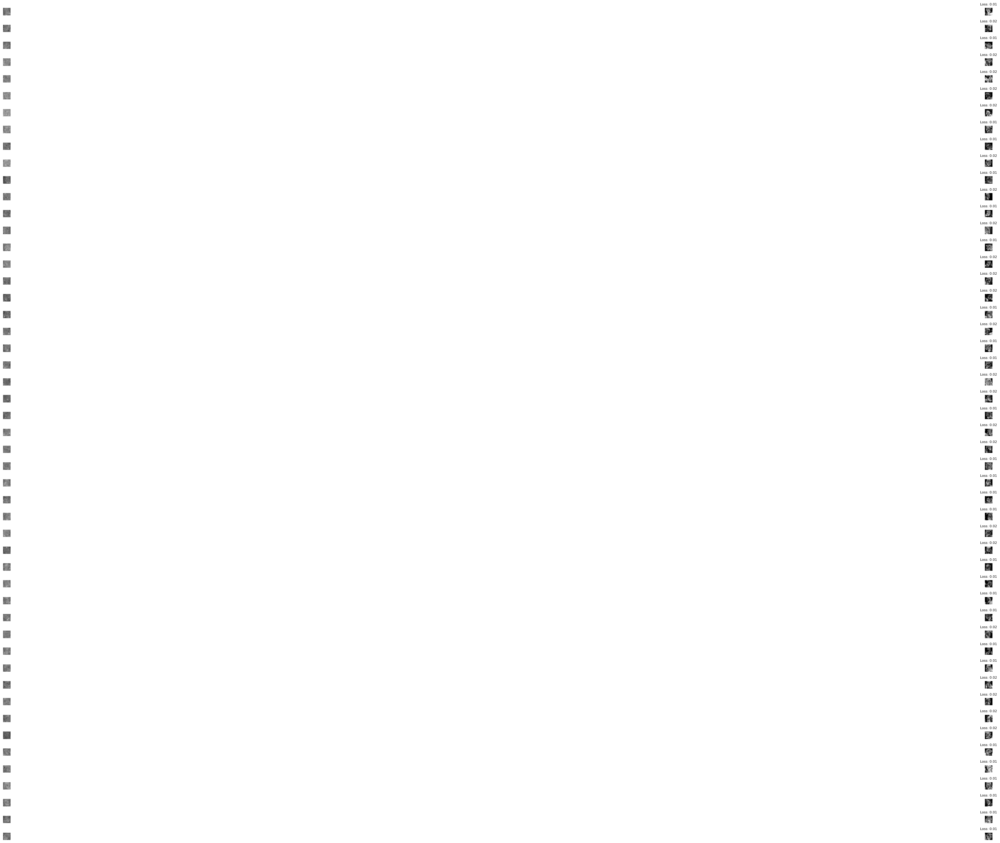

In [74]:
top_k = 1

for c in range(num_classes):
    all_img_top_k_list = []
    similarity_loss_list = []
    for latent_idx in range(args.ipc):

        k = (c, latent_idx)
        mse_val_list = sorted(mse_latent_dict[k])[:top_k]
        top_img_idx = [e[1] for e in mse_val_list]
        similarity_loss = [e[0] for e in mse_val_list]
        top_imgs = images_all[top_img_idx].detach().cpu()
        latent = torch.unsqueeze(latents_tmp[(c, latent_idx)], 0).detach().cpu()
        
        all_img_top_k = torch.cat((latent, top_imgs))
        all_img_top_k_list.append(all_img_top_k)
        similarity_loss_list.append(similarity_loss)
        

    plot_images_with_similarity(all_img_top_k_list, similarity_loss_list, args.ipc)
    break

In [72]:
top_k = 1

for c in range(num_classes):
    all_img_top_k_list = []
    similarity_loss_list = []
    for latent_idx in range(args.ipc):

        k = (c, latent_idx)
        mse_val_list = sorted(mse_latent_dict[k])[:top_k]
        top_img_idx = [e[1] for e in mse_val_list]
        similarity_loss = [e[0] for e in mse_val_list]
        top_imgs = images_all[top_img_idx].detach().cpu()
        latent = torch.unsqueeze(latents_tmp[(c, latent_idx)], 0).detach().cpu()
        
        all_img_top_k = torch.cat((latent, top_imgs))
        all_img_top_k_list.append(all_img_top_k)
        similarity_loss_list.append(similarity_loss)

    plot_images_with_similarity(all_img_top_k_list, similarity_loss_list, args.ipc)
    break
    

NameError: name 'gan_denorm' is not defined

Error in callback <function flush_figures at 0x7187e8de2e60> (for post_execute), with arguments args (),kwargs {}:


KeyboardInterrupt: 

# Train Top K Images

In [75]:
args.epoch_eval_train = 500

In [76]:
torch.random.manual_seed(0)
np.random.seed(0)
random.seed(0)

top_k = 1

print(f" ----- top k: {top_k} ----- ")
top_image_list = []
top_label_list = []

for (c, latent_idx) in tqdm(mse_latent_dict):
    k = (c, latent_idx)
    mse_val_list = sorted(mse_latent_dict[k])[:top_k]
    top_img_idx = [e[1] for e in mse_val_list]
    top_imgs = images_all[top_img_idx]
    top_image_list.append(top_imgs)
    top_label_list += [c]*top_k

top_image_list = torch.cat(top_image_list)
top_label_list = torch.tensor(top_label_list)

res_subset_dict = {}

model_eval_list = ["ConvNet"]
# model_eval_list = ["ConvNet", "ResNet18", "VGG11", "ViT"]
eval_pool_dict = get_eval_lrs(args)
for model_eval in model_eval_list:
    args.lr_net = eval_pool_dict[model_eval]
    print(f"model: {model_eval}")
    metric_train_all = []
    metric_test_all = []
    for it_eval in range(args.num_eval):
        torch.cuda.empty_cache()
        gc.collect()
        random_image_list = torch.cat([get_images(c, args.ipc) for c in range(num_classes)])
        random_label_list = torch.tensor([label for label in range(num_classes) for _ in range(args.ipc)])
        net = get_network(model_eval, channel, num_classes, im_size, depth=args.depth, width=args.width).to(args.device) # get a random model
        net.train()
        _, metric_train_list, metric_test_list = evaluate_synset(
            it_eval, net, top_image_list, top_label_list, testloader, args, decay="cosine", aug=True
        )
        metric_train_all.append(metric_train_list)
        metric_test_all.append(metric_test_list)
    res_subset_dict[model_eval] = metric_test_all

 ----- top k: 1 ----- 


  0%|          | 0/700 [00:00<?, ?it/s]

100%|██████████| 700/700 [00:01<00:00, 552.54it/s] 


model: ConvNet


100%|██████████| 500/500 [01:28<00:00,  5.66it/s]


In [78]:
dir = "../experiment_res/subset_dm" if args.use_gan else "../experiment_res/subset_dm_no_gan"
file_prefix = "subset_dm_" if args.use_gan else "subset_dm_no_gan_"
save_res_dict_excel(res_subset_dict, test_class_count, dir, file_prefix=file_prefix)

Accuracy avg:0.376539, std:0.005894


# Similar Images

In [ ]:
def plot_images_with_similarity(all_img_top_k_list, similarity_loss_list, ipc):
    # Determine the number of classes

    
    # Create a figure with subplots in a grid: num_classes rows and ipc+1 columns
    fig, axs = plt.subplots(nrows=len(all_img_top_k_list), ncols=all_img_top_k_list[0].shape[0], figsize=(ipc * 2, num_classes * 2))
    
    for i, (images, similarity_losses) in enumerate(zip(all_img_top_k_list, similarity_loss_list)):
        # print(images.shape)
        for j in range(images.shape[0]):
            ax = axs[i, j]
            if args.use_gan:
                images[j] = denorm(torch.unsqueeze(images[j], 0), channels=None, w=None ,h=None, resize = False)
            else:
                images[j] = denorm(torch.unsqueeze(images[j], 0), channels=None, w=None ,h=None, resize = False)
            img = images[j].permute(1, 2, 0)  # Convert from (C, H, W) to (H, W, C)
            ax.imshow(img.numpy())
            ax.axis('off')  # Turn off axis numbers and ticks
            
            # Annotate the top image with its similarity loss
            if j > 0:  # Skip the first image (latent image)
                ax.set_title(f"Loss: {similarity_losses[j-1]:.2f}", fontsize=8)

    plt.tight_layout()
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

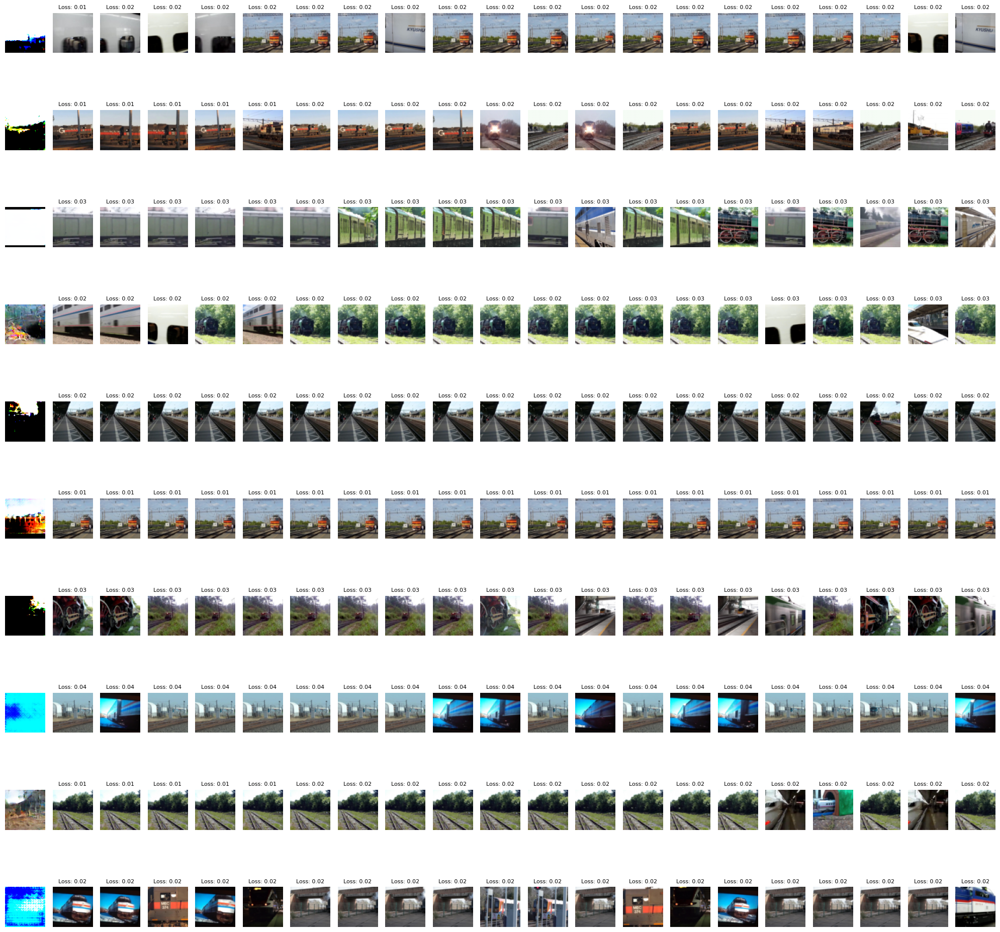

In [52]:
top_k = 20

for c in range(num_classes):
    all_img_top_k_list = []
    similarity_loss_list = []
    for latent_idx in range(args.ipc):

        k = (c, latent_idx)
        mse_val_list = sorted(mse_latent_dict[k])[:top_k]
        top_img_idx = [e[1] for e in mse_val_list]
        similarity_loss = [e[0] for e in mse_val_list]
        top_imgs = images_all[top_img_idx].detach().cpu()
        latent = torch.unsqueeze(latents_tmp[(c, latent_idx)], 0).detach().cpu()
        
        all_img_top_k = torch.cat((latent, top_imgs))
        all_img_top_k_list.append(all_img_top_k)
        similarity_loss_list.append(similarity_loss)
        

    plot_images_with_similarity(all_img_top_k_list, similarity_loss_list, args.ipc)
    break

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

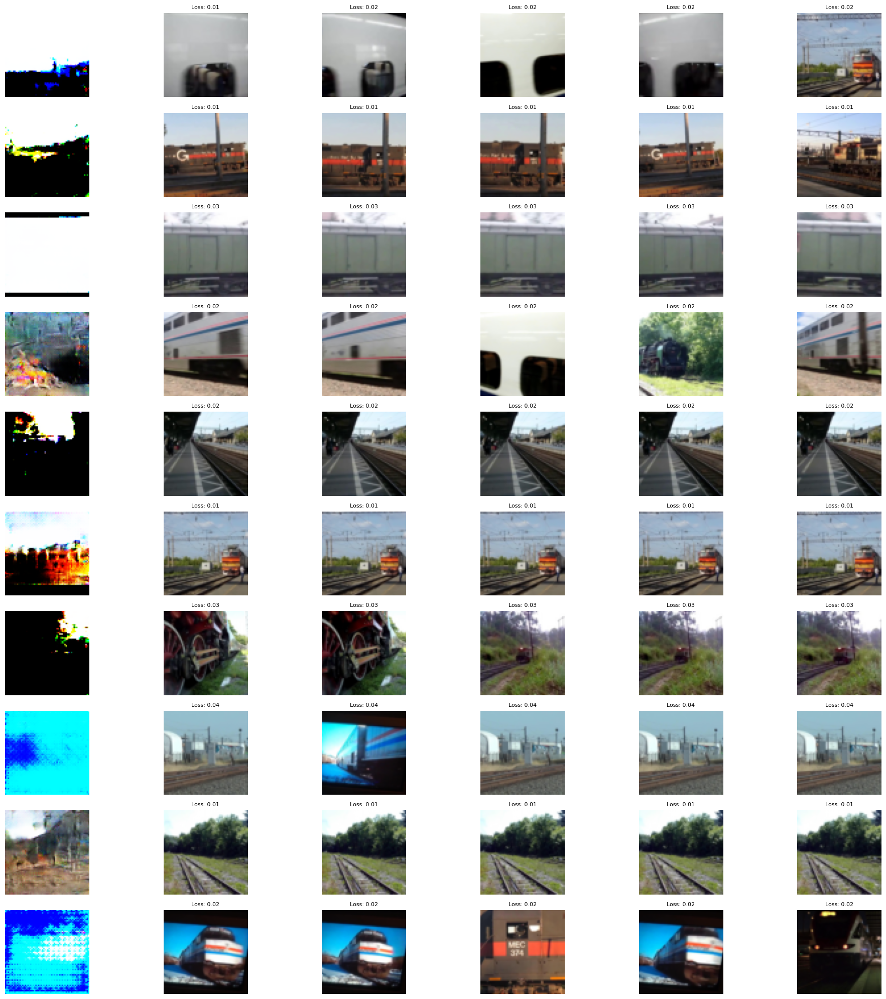

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

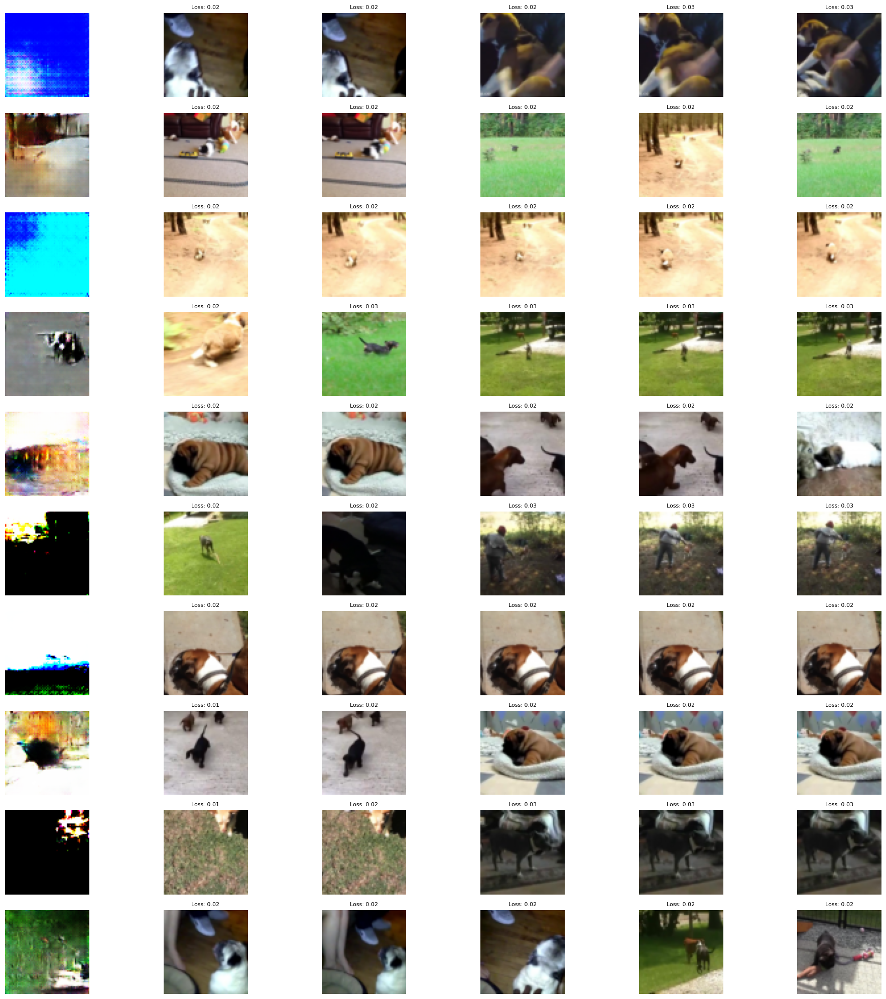

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

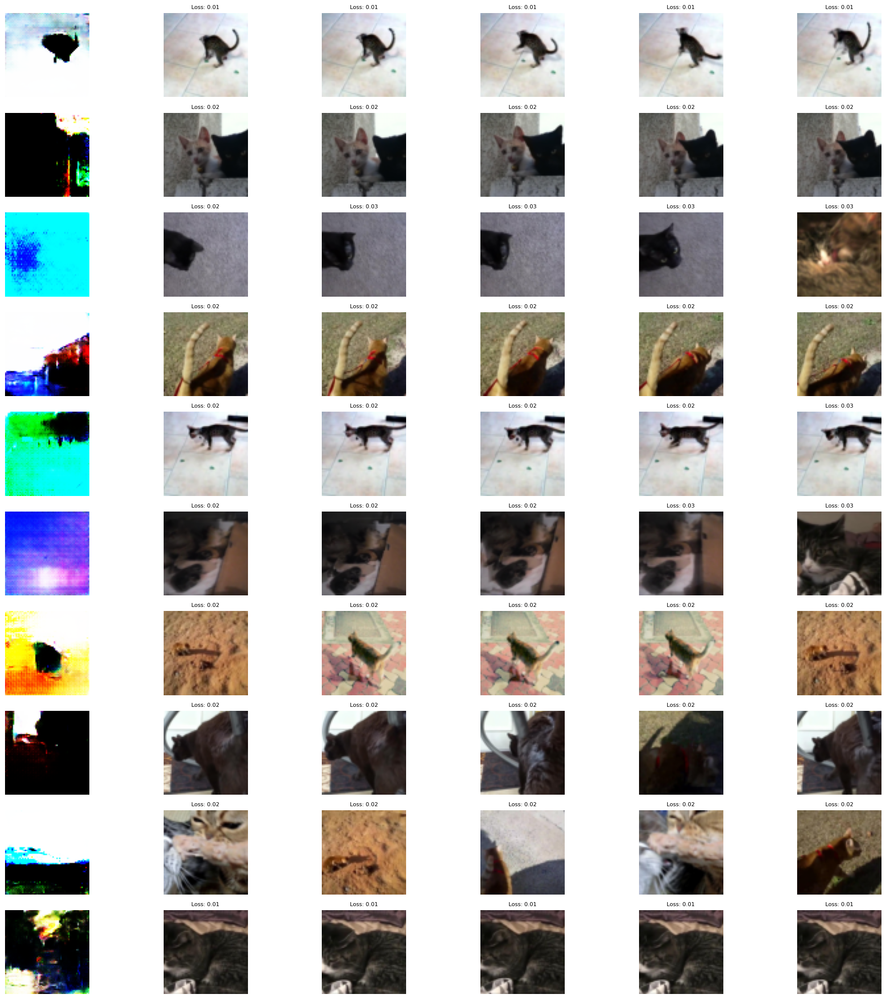

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

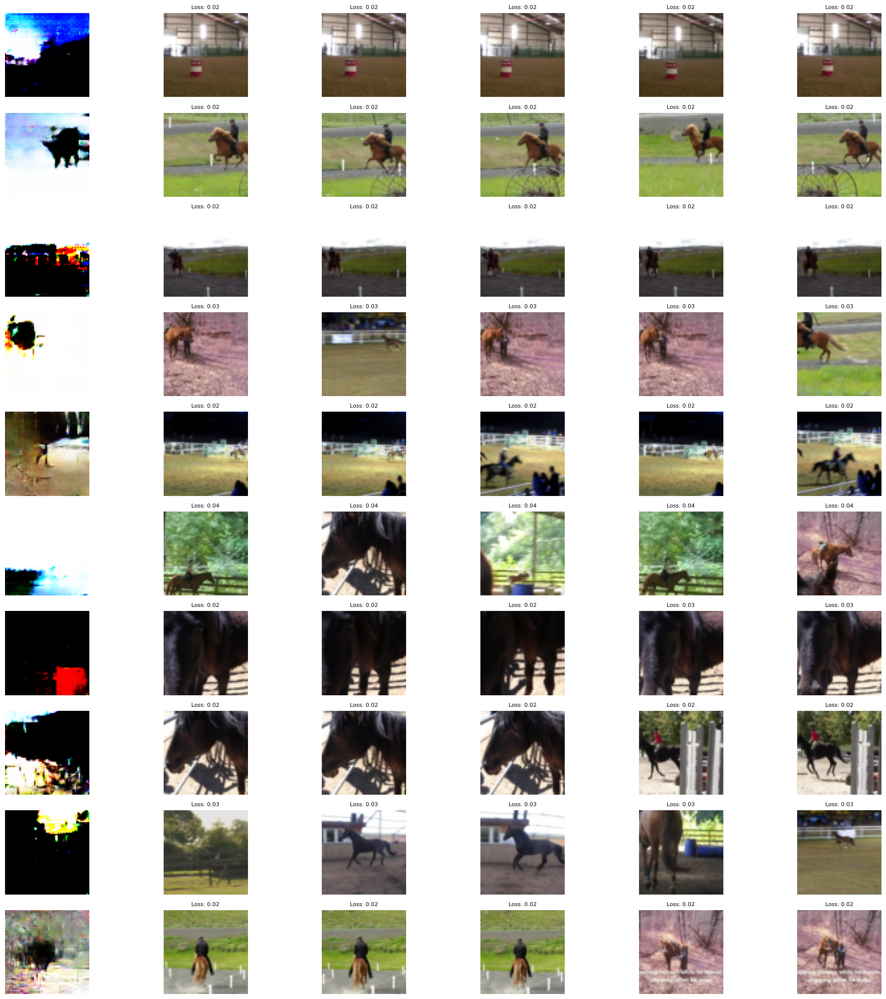

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

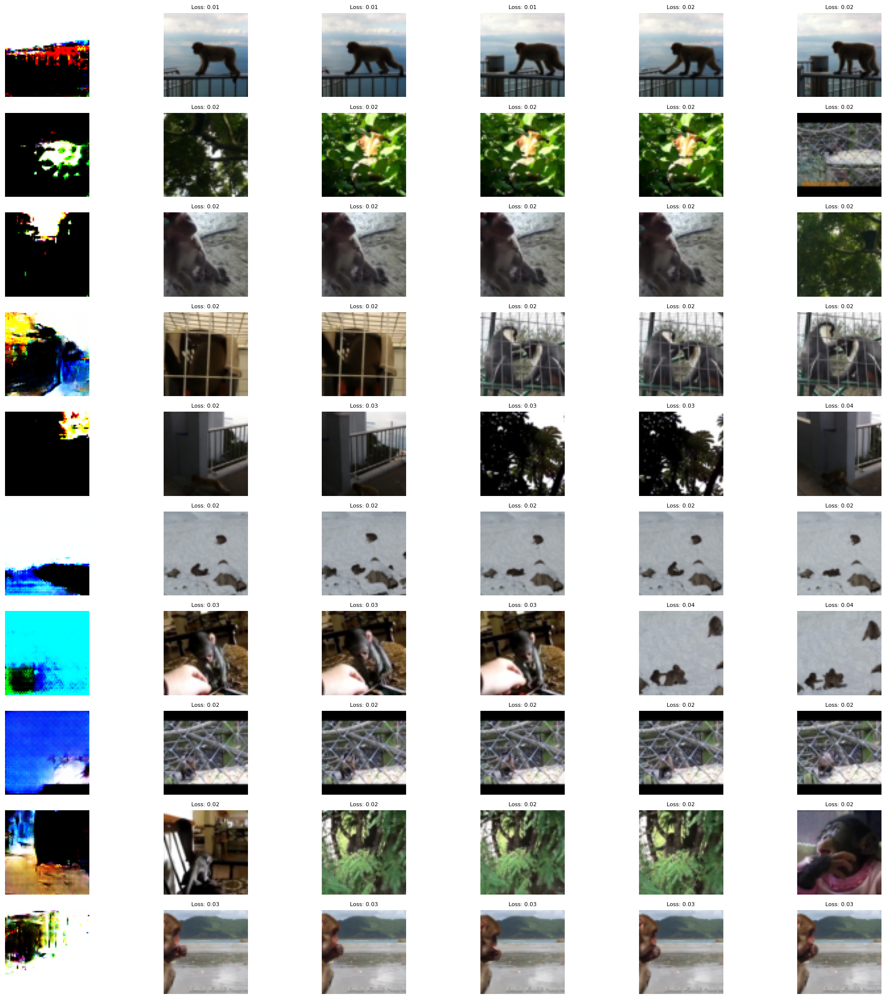

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


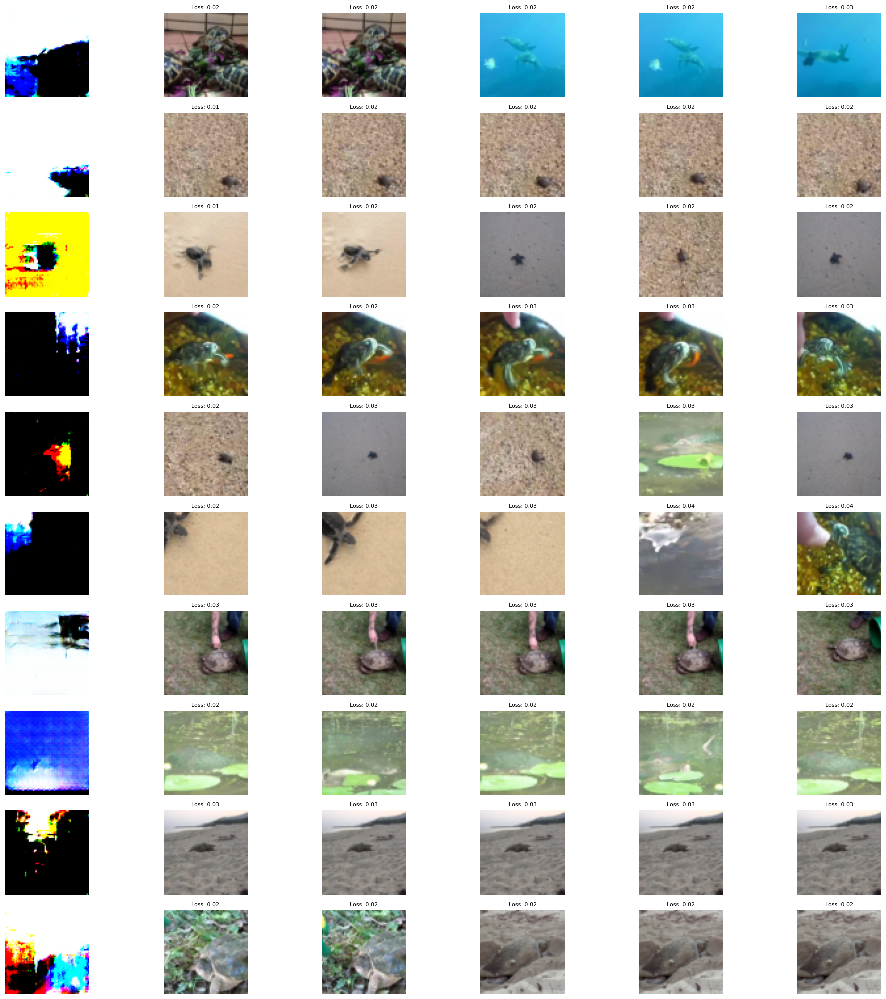

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


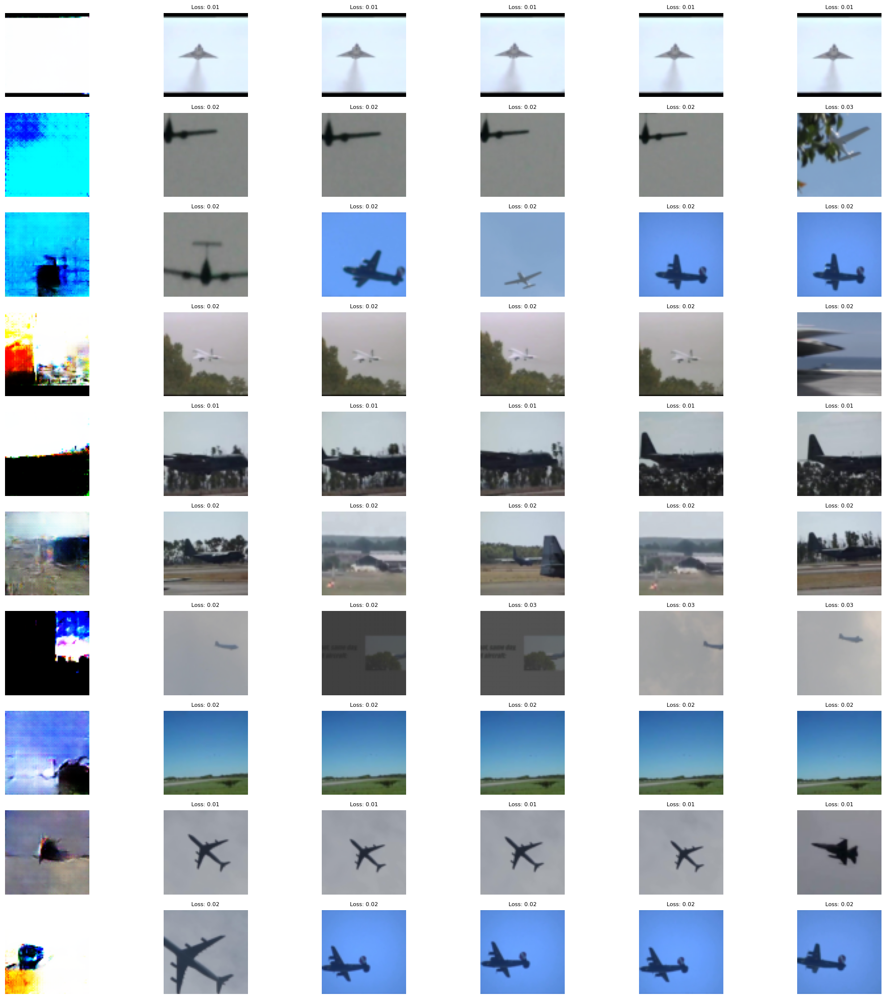

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

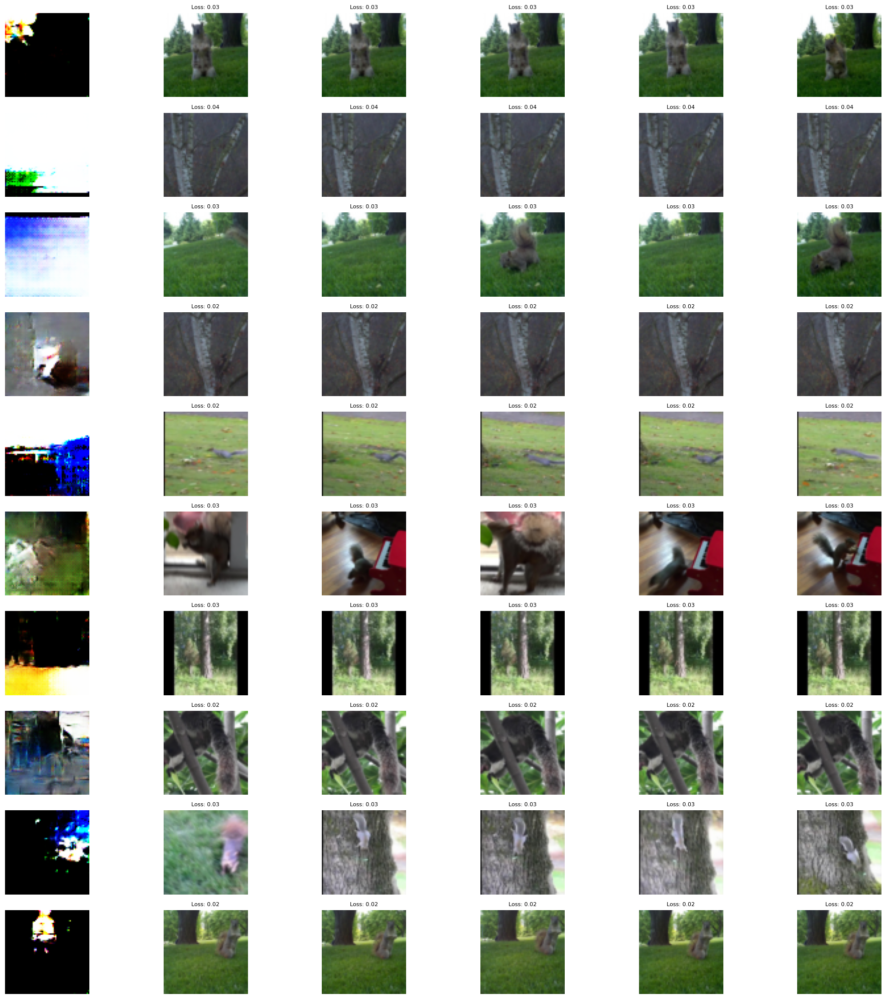

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


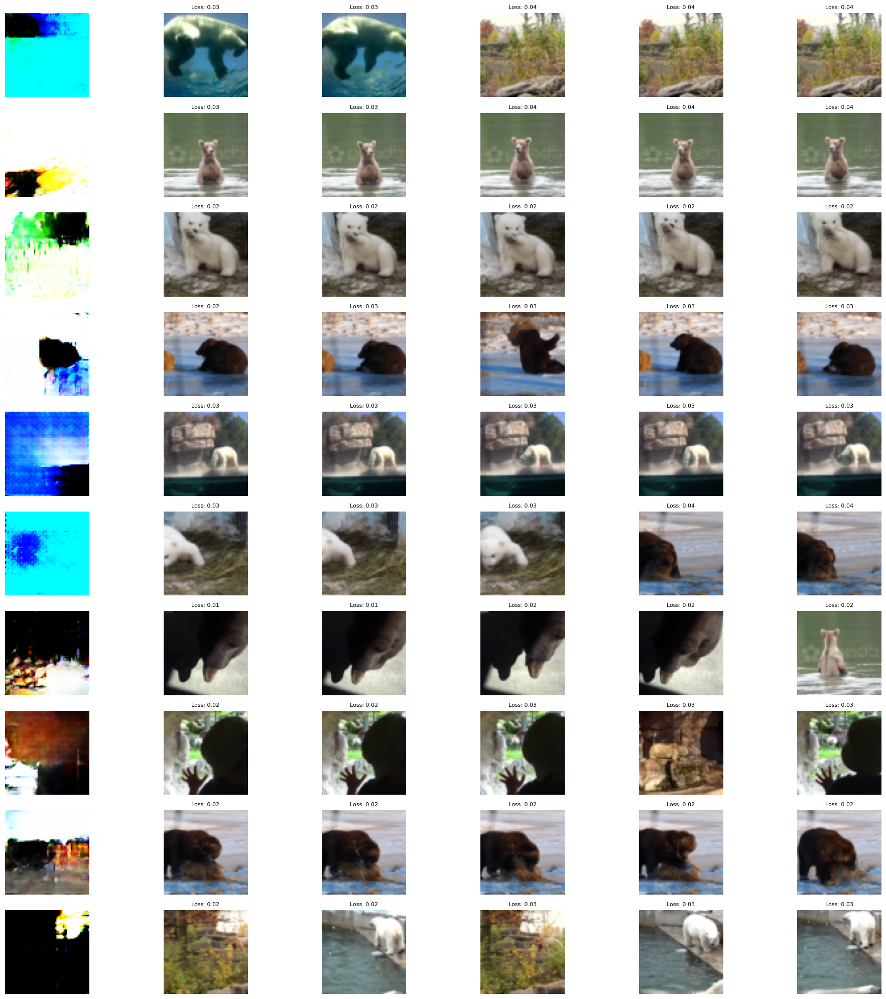

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

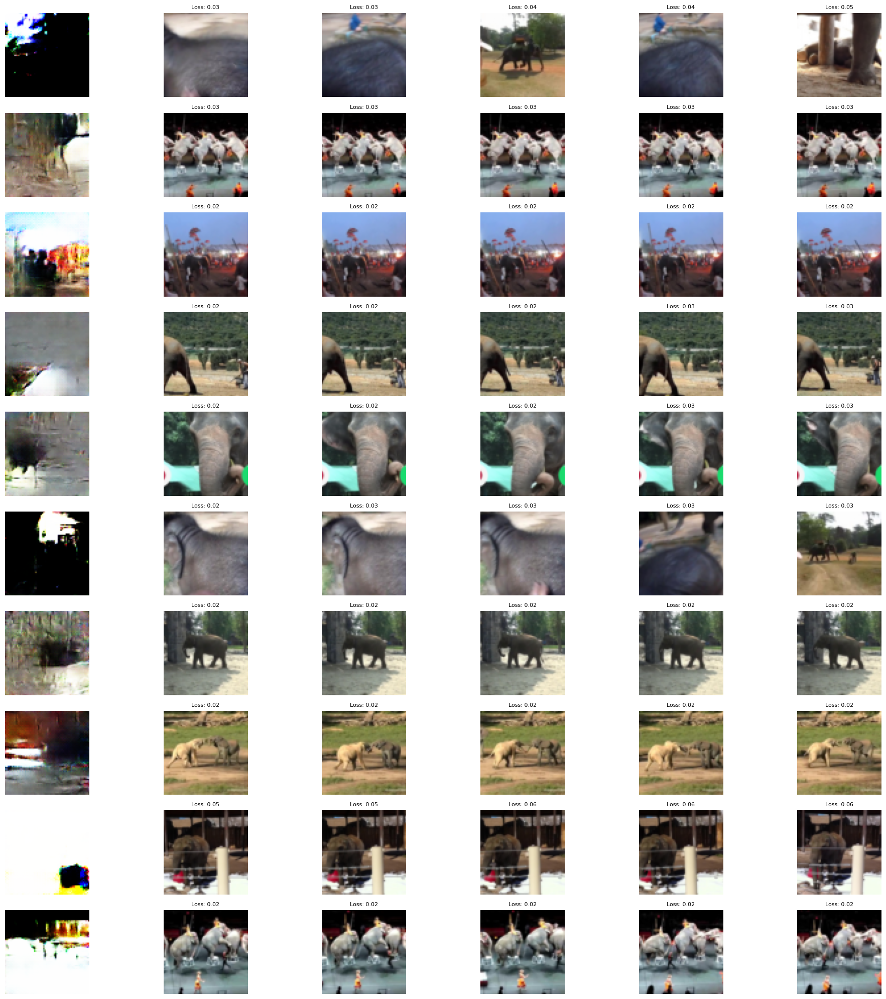

In [53]:
top_k = 5

for c in range(num_classes):
    all_img_top_k_list = []
    similarity_loss_list = []
    for latent_idx in range(args.ipc):

        k = (c, latent_idx)
        mse_val_list = sorted(mse_latent_dict[k])[:top_k]
        top_img_idx = [e[1] for e in mse_val_list]
        similarity_loss = [e[0] for e in mse_val_list]
        top_imgs = images_all[top_img_idx].detach().cpu()
        latent = torch.unsqueeze(latents_tmp[(c, latent_idx)], 0).detach().cpu()
        
        all_img_top_k = torch.cat((latent, top_imgs))
        all_img_top_k_list.append(all_img_top_k)
        similarity_loss_list.append(similarity_loss)

    plot_images_with_similarity(all_img_top_k_list, similarity_loss_list, args.ipc)
    # break